In [2]:
#import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy
import scipy.interpolate as interp
import gzip
import pickle as pkl

In [3]:
# load data
file = gzip.GzipFile('GlobalTemperatureData.pkl.gz','rb')
df = pkl.load(file)
file.close

<bound method GzipFile.close of <gzip _io.BufferedReader name='GlobalTemperatureData.pkl.gz' 0x1862ecc91f0>>

In [4]:
#Data Source:https://data.giss.nasa.gov/gistemp/
df.keys()

dict_keys(['YR1881', 'YR1882', 'YR1883', 'YR1884', 'YR1885', 'YR1886', 'YR1887', 'YR1888', 'YR1889', 'YR1890', 'YR1891', 'YR1892', 'YR1893', 'YR1894', 'YR1895', 'YR1896', 'YR1897', 'YR1898', 'YR1899', 'YR1900', 'YR1901', 'YR1902', 'YR1903', 'YR1904', 'YR1905', 'YR1906', 'YR1907', 'YR1908', 'YR1909', 'YR1910', 'YR1911', 'YR1912', 'YR1913', 'YR1914', 'YR1915', 'YR1916', 'YR1917', 'YR1918', 'YR1919', 'YR1920', 'YR1921', 'YR1922', 'YR1923', 'YR1924', 'YR1925', 'YR1926', 'YR1927', 'YR1928', 'YR1929', 'YR1930', 'YR1931', 'YR1932', 'YR1933', 'YR1934', 'YR1935', 'YR1936', 'YR1937', 'YR1938', 'YR1939', 'YR1940', 'YR1941', 'YR1942', 'YR1943', 'YR1944', 'YR1945', 'YR1946', 'YR1947', 'YR1948', 'YR1949', 'YR1950', 'YR1951', 'YR1952', 'YR1953', 'YR1954', 'YR1955', 'YR1956', 'YR1957', 'YR1958', 'YR1959', 'YR1960', 'YR1961', 'YR1962', 'YR1963', 'YR1964', 'YR1965', 'YR1966', 'YR1967', 'YR1968', 'YR1969', 'YR1970', 'YR1971', 'YR1972', 'YR1973', 'YR1974', 'YR1975', 'YR1976', 'YR1977', 'YR1978', 'YR1979',

In [5]:
YR = list(df.keys())
print(YR)

['YR1881', 'YR1882', 'YR1883', 'YR1884', 'YR1885', 'YR1886', 'YR1887', 'YR1888', 'YR1889', 'YR1890', 'YR1891', 'YR1892', 'YR1893', 'YR1894', 'YR1895', 'YR1896', 'YR1897', 'YR1898', 'YR1899', 'YR1900', 'YR1901', 'YR1902', 'YR1903', 'YR1904', 'YR1905', 'YR1906', 'YR1907', 'YR1908', 'YR1909', 'YR1910', 'YR1911', 'YR1912', 'YR1913', 'YR1914', 'YR1915', 'YR1916', 'YR1917', 'YR1918', 'YR1919', 'YR1920', 'YR1921', 'YR1922', 'YR1923', 'YR1924', 'YR1925', 'YR1926', 'YR1927', 'YR1928', 'YR1929', 'YR1930', 'YR1931', 'YR1932', 'YR1933', 'YR1934', 'YR1935', 'YR1936', 'YR1937', 'YR1938', 'YR1939', 'YR1940', 'YR1941', 'YR1942', 'YR1943', 'YR1944', 'YR1945', 'YR1946', 'YR1947', 'YR1948', 'YR1949', 'YR1950', 'YR1951', 'YR1952', 'YR1953', 'YR1954', 'YR1955', 'YR1956', 'YR1957', 'YR1958', 'YR1959', 'YR1960', 'YR1961', 'YR1962', 'YR1963', 'YR1964', 'YR1965', 'YR1966', 'YR1967', 'YR1968', 'YR1969', 'YR1970', 'YR1971', 'YR1972', 'YR1973', 'YR1974', 'YR1975', 'YR1976', 'YR1977', 'YR1978', 'YR1979', 'YR1980',

In [6]:
iyr = 10
df_yr = df[YR[iyr]]


In [7]:
df_yr

,i,j,lon,lat,"Temperature(i,j)"
0,1,1,-179,-89,9999.0
1,2,1,-177,-89,9999.0
2,3,1,-175,-89,9999.0
3,4,1,-173,-89,9999.0
4,5,1,-171,-89,9999.0
...,...,...,...,...,...
16195,176,90,171,89,9999.0
16196,177,90,173,89,9999.0
16197,178,90,175,89,9999.0
16198,179,90,177,89,9999.0


In [8]:
data = df_yr[['lon','lat','Temperature(i,j)']].to_numpy()

In [9]:
data[np.where(data>999)] = np.nan
data

array([[-179.,  -89.,   nan],
       [-177.,  -89.,   nan],
       [-175.,  -89.,   nan],
       ...,
       [ 175.,   89.,   nan],
       [ 177.,   89.,   nan],
       [ 179.,   89.,   nan]])

In [10]:
#grid
x=np.linspace(-180,180,100)
y=np.linspace(-90,90,100)
grid_x,grid_y = np.meshgrid(x,y)

In [11]:
#data interpolate
data_interp=interp.griddata(data[:,[0,1]],data[:,2],(grid_x,grid_y),method='linear')

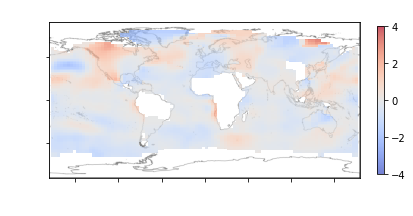

In [12]:
#plot
from turtle import color


hfig,hax = plt.subplots()
im = plt.imread('world_map.png')
plt.imshow(np.flipud(im), origin='lower',extent=(-180,180,-90,90))
plt.pcolormesh(grid_x,grid_y,data_interp,cmap='coolwarm',alpha=0.7)
plt.xlim(-180,180)
plt.ylim(-90,90)
plt.xlabel('Latitude',color='#fff')
plt.ylabel('Longitude',color='#fff')
plt.xticks(color='#fff')
plt.yticks(color='#fff')
plt.title('global Temperature Change From YR1880 To '+str(YR[iyr]),color='#fff')
plt.colorbar(fraction=0.022,pad=0.05)
plt.clim(-4,4)

In [13]:
len(YR)

139

# Animate Graph

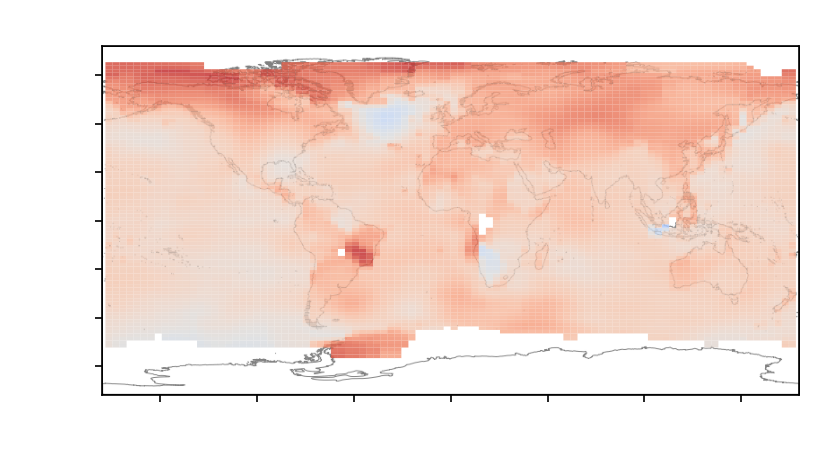

In [14]:
import matplotlib.animation
matplotlib.rcParams['animation.embed_limit'] = 100 #in MByte

plt.rcParams["animation.html"]='jshtml'
plt.rcParams['figure.dpi']= 150
plt.ioff()

hfig,hax = plt.subplots()

def animate(iyr):
    df_yr = df[YR[iyr]]
    data = df_yr[['lon','lat','Temperature(i,j)']].to_numpy()
    data[np.where(data>999)]= np.nan
    data_interp = interp.griddata(data[:,[0,1]],data[:,2],(grid_x,grid_y),method='linear')
    plt.clf()
    plt.cla()

    plt.imshow(np.flipud(im),origin='lower',extent=(-180,180,-90,90))
    plt.pcolor(grid_x,grid_y,data_interp,cmap='coolwarm',alpha=0.85, edgecolors=None)
    
    plt.xlim(-180,180)
    plt.ylim(-90,90)
    plt.title('Global Temperature Change From YR1880 To '+str(YR[iyr]),color='#fff')
    plt.xlabel('Latitude',color='#fff')
    plt.ylabel('Longitude',color='#fff')
    plt.xticks(color='#fff')
    plt.yticks(color='#fff')
    plt.clim(-4,4)



matplotlib.animation.FuncAnimation(hfig,animate,frames=136)

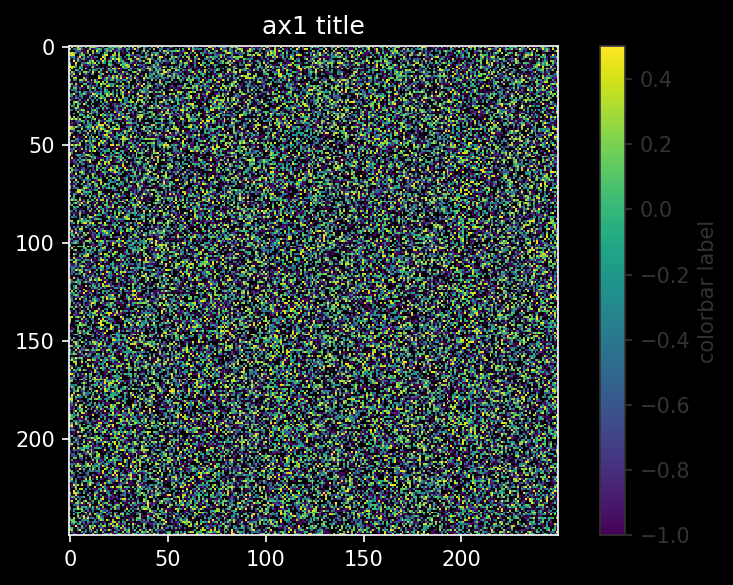

In [15]:
import matplotlib.pyplot as plt
import numpy as np
from numpy.random import randn
data = np.clip(randn(250,250),-1,1)
data = np.ma.masked_where(data > 0.5, data)


fig, ax1 = plt.subplots(1,1)

im = ax1.imshow(data, interpolation='nearest')
cb = plt.colorbar(im)

fg_color = 'white'
bg_color = 'black'

# IMSHOW    
# set title plus title color
ax1.set_title('ax1 title', color=fg_color)

# set figure facecolor
ax1.patch.set_facecolor(bg_color)

# set tick and ticklabel color
im.axes.tick_params(color=fg_color, labelcolor=fg_color)

# set imshow outline
for spine in im.axes.spines.values():
    spine.set_edgecolor(fg_color)    

# COLORBAR
# set colorbar label plus label color
cb.set_label('colorbar label', color='#333')

# set colorbar tick color
cb.ax.yaxis.set_tick_params(color='#333')

# set colorbar edgecolor 
cb.outline.set_edgecolor('#333')

# set colorbar ticklabels
plt.setp(plt.getp(cb.ax.axes, 'yticklabels'), color='#333')

fig.patch.set_facecolor(bg_color)    
plt.tight_layout()
plt.show()
#plt.savefig('save/to/pic.png', dpi=200, facecolor=bg_color)